# FINAL PROJECT
 - Eliav Dayanof : 208674556
 - David Orenstein : 209040112
 - Chaya Lasry : 209911379


## imports

In [7]:
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.preprocessing import StandardScaler
import numpy as np
import seaborn as sns
%matplotlib inline
import matplotlib
import warnings
# import joypy
import folium
from ydata_profiling import ProfileReport
from collections import Counter
import pickle
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

np.set_printoptions(suppress=True)
warnings.filterwarnings('ignore')
plt.style.use('ggplot')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (18,8)
matplotlib.rcParams['figure.autolayout'] = True
PRE_PATH = ""

# Initial Data Analysis (IDA)

### Saving a figure to svg file


In [113]:
save_fig = lambda fig_name: plt.savefig(f"visualizations/{fig_name}.svg", bbox_inches='tight')

## Missing values

In [ ]:
df_orig = pd.read_csv(f"{PRE_PATH}train_data.csv")
df_orig.info()
df = df_orig

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 626822 entries, 0 to 626821
Data columns (total 40 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   Unnamed: 0                  626822 non-null  int64  
 1   OBJECTID                    626822 non-null  int64  
 2   FOD_ID                      626822 non-null  int64  
 3   FPA_ID                      626822 non-null  object 
 4   SOURCE_SYSTEM_TYPE          626822 non-null  object 
 5   SOURCE_SYSTEM               626822 non-null  object 
 6   NWCG_REPORTING_AGENCY       626822 non-null  object 
 7   NWCG_REPORTING_UNIT_ID      626822 non-null  object 
 8   NWCG_REPORTING_UNIT_NAME    626822 non-null  object 
 9   SOURCE_REPORTING_UNIT       626822 non-null  object 
 10  SOURCE_REPORTING_UNIT_NAME  626822 non-null  object 
 11  LOCAL_FIRE_REPORT_ID        140480 non-null  object 
 12  LOCAL_INCIDENT_ID           353364 non-null  object 
 13  FIRE_CODE     

In [ ]:
df_orig.duplicated().sum()

0

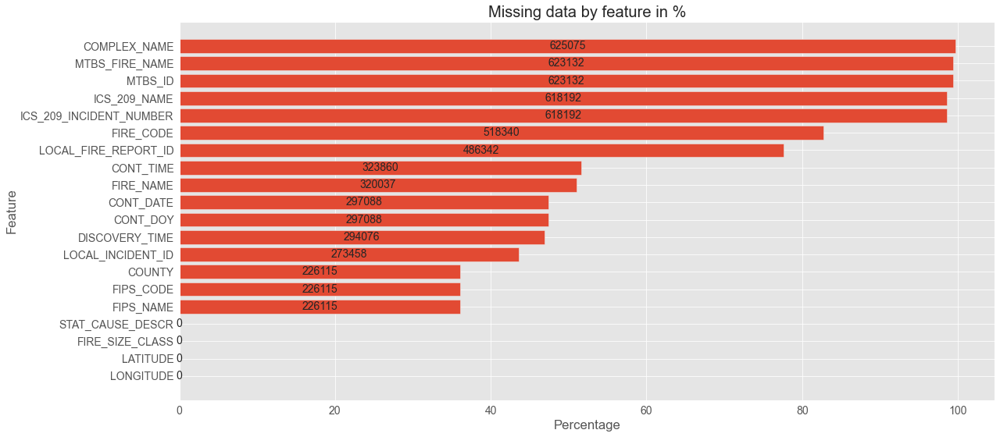

In [ ]:
# matplotlib.rcParams['figure.figsize'] = (10,8)
def plot_missing(data):
    # Relevant data
    missing_per = data.isna().mean().sort_values(ascending=False)[:20][::-1] * 100
    missing_abs = data.isna().sum().sort_values(ascending=False)[:20][::-1]

    # Set up plot
    fig, ax = plt.subplots()
    ax.use_sticky_edges = True
    bars = ax.barh(missing_per.index, missing_per)

    # Set the axis labels and title
    ax.set_xlabel('Percentage')
    ax.set_ylabel('Feature')
    ax.set_title('Missing data by feature in %')

    # Add absolute values as annotation after bars
    ax.bar_label(ax.containers[0], labels=missing_abs,
                 label_type='center')  # label_type='center': center labels on top of the bars

    # plt.tight_layout()
    plt.autoscale()
    import os.path

    if not os.path.isfile("visualizations/missing_values_by_feat_in%.svg"):
        save_fig('missing_values_by_feat_in')
    plt.show()

plot_missing(df_orig)

# Initial Data Prepocessing

In [117]:
def process_date(data):
    data['DATE'] = pd.to_datetime(data['DISCOVERY_DATE'], unit='D', origin='julian')
    data['MONTH'] = pd.DatetimeIndex(data['DATE']).month
    data['DAY_OF_WEEK'] = data['DATE'].dt.day_name()
    data['DAY_OF_MONTH'] = data['DATE'].dt.day
    return data


In [118]:
def base_preprocessing(data: pd.DataFrame) -> pd.DataFrame:
    data = data.copy()
    base_cols = ['STAT_CAUSE_DESCR',
      'DAY_OF_MONTH',
      'MONTH',
      'FIRE_YEAR',
      'STATE',
      'DAY_OF_WEEK',
      'FIRE_SIZE',
      'LATITUDE',
      'LONGITUDE',
      'DISCOVERY_DOY',
      'DATE',
       
      'DISCOVERY_TIME', 'OWNER_CODE']
    data = process_date(data)
    data = data[base_cols]
    return data



## Date

In [119]:
def encode_time(df, encoding='ordered'):
    if encoding == 'ordered':
        weekday_dict = {'Monday': 1, 'Tuesday': 2, 'Wednesday': 3, 'Thursday': 4, 'Friday': 5, 'Saturday': 6, 'Sunday': 7}
        df['DAY_OF_WEEK'] = df['DAY_OF_WEEK'].map(weekday_dict)
    elif encoding == 'codes':
        df["DAY_OF_WEEK"] = df['DATE'].dt.dayofweek # Integer encoding for DAY_OF_WEEK
    df = df.drop('DATE', axis=1) # Can't have date in model
    return df

## State

In [120]:
def encode_state(df, encoding='codes'):
    """
    :param encoding: 'codes' - Regular code categorical encoding, 'OHE' - One-Hot Encoding
    """
    df['STATE'] = df['STATE'].astype('category').cat.codes
    
    return df


## Label

In [121]:
def encode_label(df, encoding='code'):
    if encoding == 'given':
        df = df.drop('STAT_CAUSE_DESCR', axis=1)
        df = df.rename(columns={'STAT_CAUSE_CODE':'CAUSE'})
    elif encoding == 'codes': # Integer encoding for label
        df['CAUSE'] = df['STAT_CAUSE_DESCR'].astype('category').cat.codes
        df = df.drop(['STAT_CAUSE_CODE','STAT_CAUSE_DESCR'], axis=1)
    elif encoding == 'OHE': # One-hot encoding for label
        df['CAUSE']= pd.get_dummies(df, columns=['STAT_CAUSE_DESCR'])
    elif encoding == 'LabelEncoder':
        le = preprocessing.LabelEncoder()


    df = df.rename(columns={"STAT_CAUSE_CODE": "CAUSE"})
    return df



# Exploratory Data Analysis (EDA)

## Fireworks at independence day

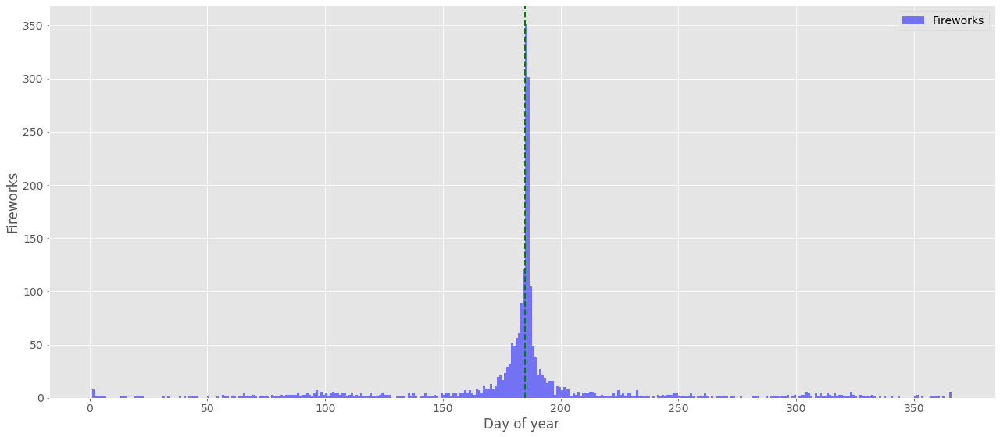

In [34]:
def show_fireworks_all_day(data):
  independence_DOY = 185

  plt.hist(data[data['STAT_CAUSE_DESCR'] == 'Fireworks']['DISCOVERY_DOY'], bins=365, alpha=0.5, color='blue', label='Fireworks')
  plt.axvline(x=independence_DOY, color='green', linestyle='--', linewidth=2)

  plt.legend()
  plt.xlabel('Day of year')
  plt.ylabel('Fireworks')
  # Show the plot
  plt.show()
show_fireworks_all_day(df)

## Label Vs Feature

In [25]:
def label_vs_feature(data, feature):

    # Group the data by cause and holiday status
    grouped = data.groupby(['STAT_CAUSE_DESCR', feature]).size().unstack(fill_value=0)

    # Calculate the percentage of incidents for each cause on each holiday and normal day
    grouped_pct = grouped.div(grouped.sum(axis=1), axis=0) * 100
    ## Reshape the DataFrame to make it easier to plot with seaborn
    grouped_pct = grouped_pct.stack().reset_index(name='Percentage').rename(columns={'level_1': feature})

    # Plot the data using a bar plot
    plt.figure(figsize=(30,30))
    fig = sns.catplot(data=grouped_pct, x='STAT_CAUSE_DESCR', y='Percentage', hue=feature, kind='bar', height=6, aspect=2)
    plt.xticks(rotation=90)

    fig.savefig(f"{PRE_PATH}visualizations/{feature}_vs_feature.svg")


### LAbel VS SOURCE_SYSTEM_TYPE

<Figure size 2160x2160 with 0 Axes>

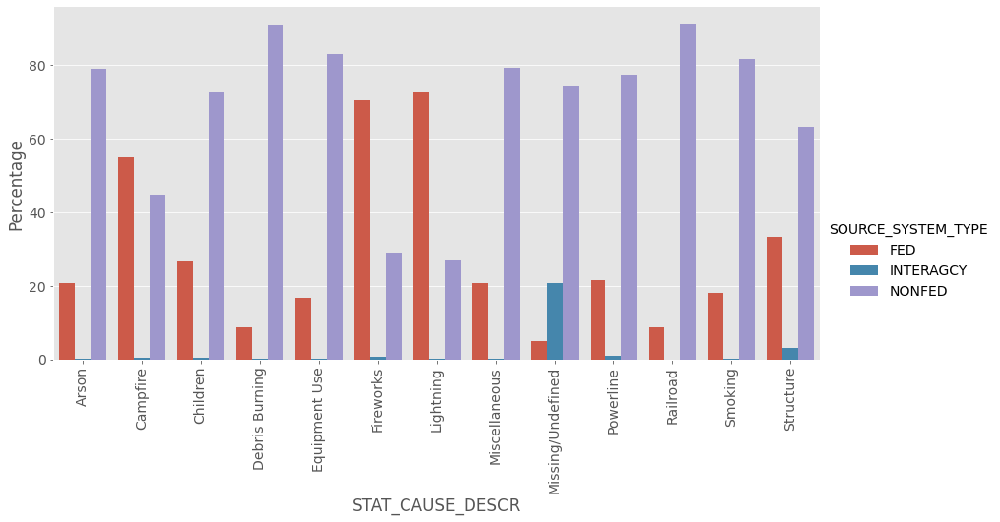

In [26]:
label_vs_feature(df_orig, "SOURCE_SYSTEM_TYPE")

### LAbel VS OWNER_DESCR

<Figure size 2160x2160 with 0 Axes>

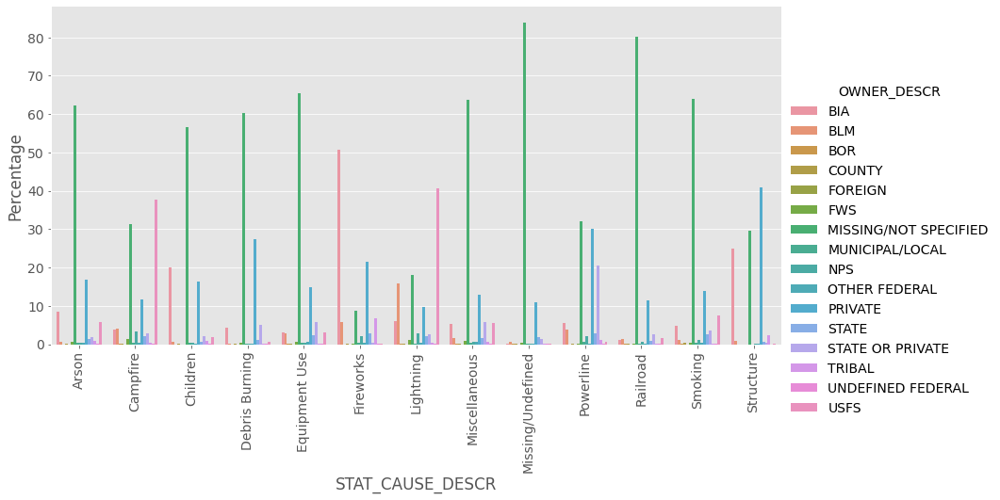

In [27]:
label_vs_feature(df_orig, "OWNER_DESCR")

## Color Maps

In [ ]:
import folium
def color_map(data, feature):
  common_causes = data[feature].value_counts().index[:5].tolist()
  df_common = data[data[feature].isin(common_causes)].sample(n =15000)
  map_obj = folium.Map(location = [38.27312, -98.5821872], zoom_start = 4)
  folium.TileLayer('cartodbdark_matter').add_to(map_obj)
  colormap = dict(zip(common_causes, ['green','yellow','red', 'white', 'blue']))
  for lat, lng, feature in zip(df_common['LATITUDE'], df_common['LONGITUDE'],
                                              df_common[feature]):
      folium.vector_layers.CircleMarker(
          [lat, lng],
          radius=-1,
          tooltip = str(feature),
          fill=True,
          color=colormap[feature],
          fill_opacity=0.9).add_to(map_obj)
  # save_fig(f"colormap_{str(feature)}")
  return map_obj

### Cause of fire color map

In [ ]:
map_obj = color_map(df[df['STAT_CAUSE_DESCR'] != "Missing/Undefined"], "STAT_CAUSE_DESCR")
map_obj

### Owner color map

In [ ]:
map_obj = color_map(df_orig[(df_orig['OWNER_DESCR'] != "MISSING/NOT SPECIFIED")], 'OWNER_DESCR')
map_obj

## Cont Doy (day of year) counts

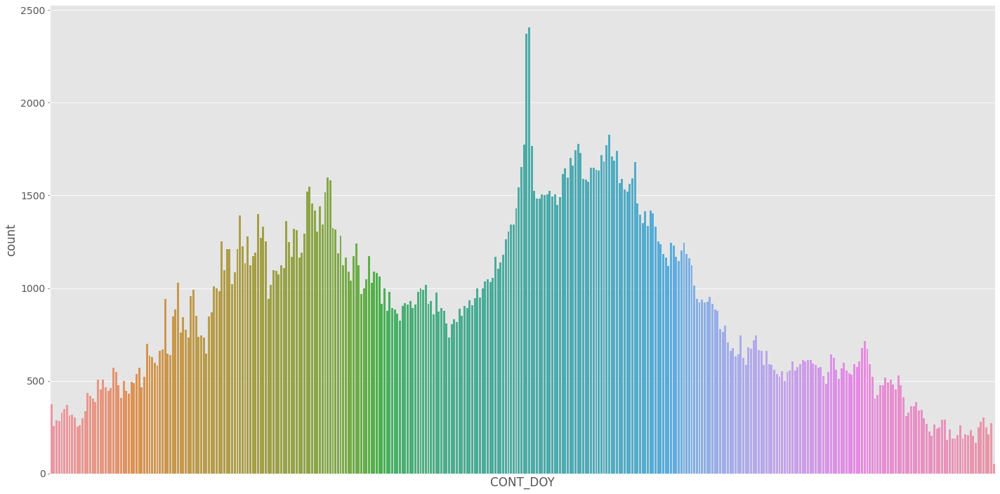

In [ ]:
plt.figure(figsize=(20,10))
sns.countplot(df_orig.CONT_DOY)
plt.xticks(ticks=[])
plt.grid(True)

## Label distribution pie chart

In [ ]:
#from pure_functions import pie_chart_new
#pie_chart_new(df['STAT_CAUSE_DESCR'])

different unique values: 13


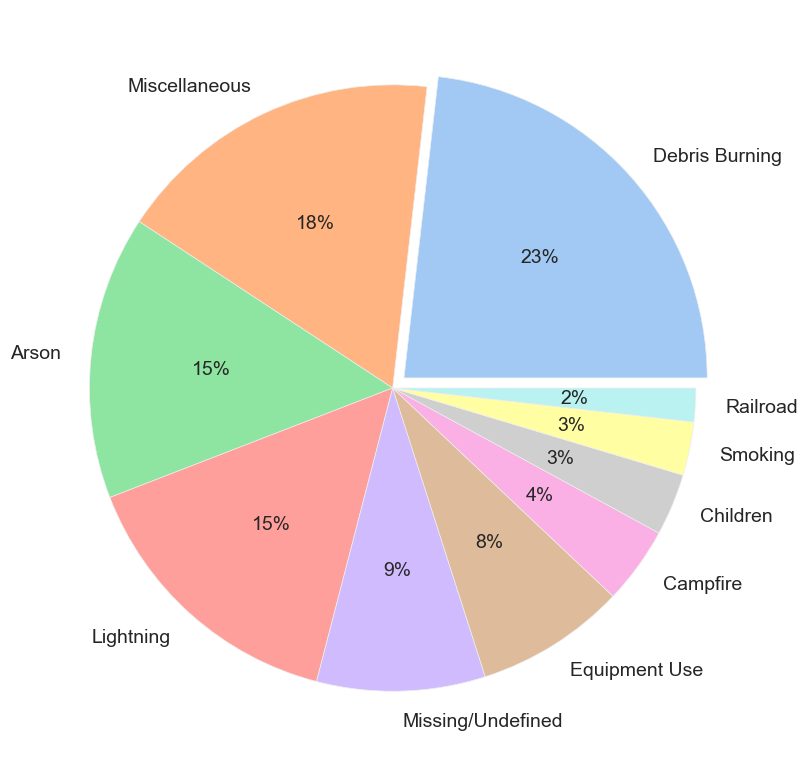

In [ ]:
def pie_chart(data):
    count = Counter(data)
    max_n = len(count.values())
    print("different unique values:",max_n)
    max_n = 10
    most_common = dict(count.most_common(10))
    colors = sns.color_palette('pastel')[0:max_n]
    plt.pie(most_common.values(),labels =most_common.keys(),colors = colors, explode=[0.05]+([0] * (max_n-1)), autopct='%.0f%%')
    plt.show()

pie_chart(df['STAT_CAUSE_DESCR'])

In [ ]:
labels = list(df.STAT_CAUSE_DESCR.value_counts().index)
print(labels)

['Debris Burning', 'Miscellaneous', 'Arson', 'Lightning', 'Missing/Undefined', 'Equipment Use', 'Campfire', 'Children', 'Smoking', 'Railroad', 'Powerline', 'Fireworks', 'Structure']


Debris Burning
Miscellaneous
Arson
Lightning
Missing/Undefined
Equipment Use
Campfire
Children
Smoking
Railroad
Powerline
Fireworks
Structure


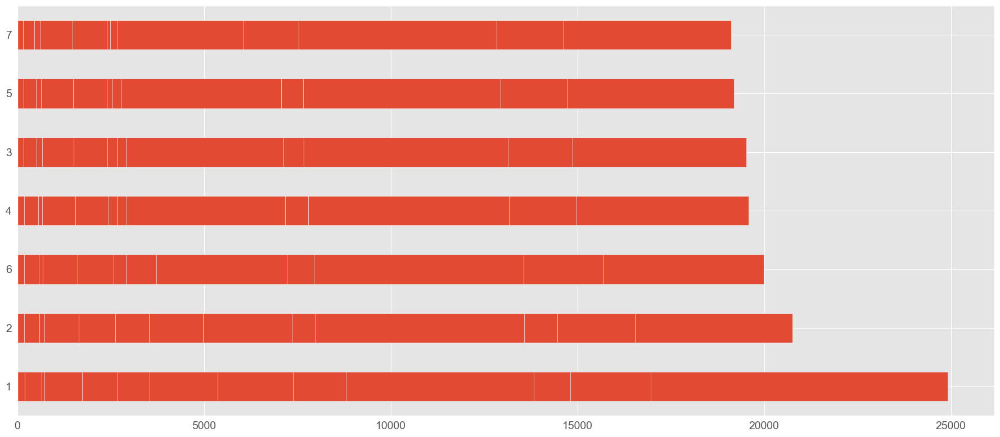

In [ ]:
for label in labels:
    print(label)
    tmp = df[df['STAT_CAUSE_DESCR'] == label]
    # print(tmp.head())
    tmp['DAY_OF_WEEK'].value_counts().plot(kind='barh')

## Cause of fire count by day of week

In [ ]:
days_of_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
# df['DAY_OF_WEEK'] = pd.Categorical(df['DAY_OF_WEEK'], categories=days_of_week, ordered=True)
grouped = df.groupby(['STAT_CAUSE_DESCR', 'DAY_OF_WEEK']).size().reset_index(name='count')
grouped

,STAT_CAUSE_DESCR,DAY_OF_WEEK,count
0,Arson,1,13464
1,Arson,2,12710
2,Arson,3,12816
3,Arson,4,12494
4,Arson,5,12549
...,...,...,...
86,Structure,3,174
87,Structure,4,181
88,Structure,5,165
89,Structure,6,186


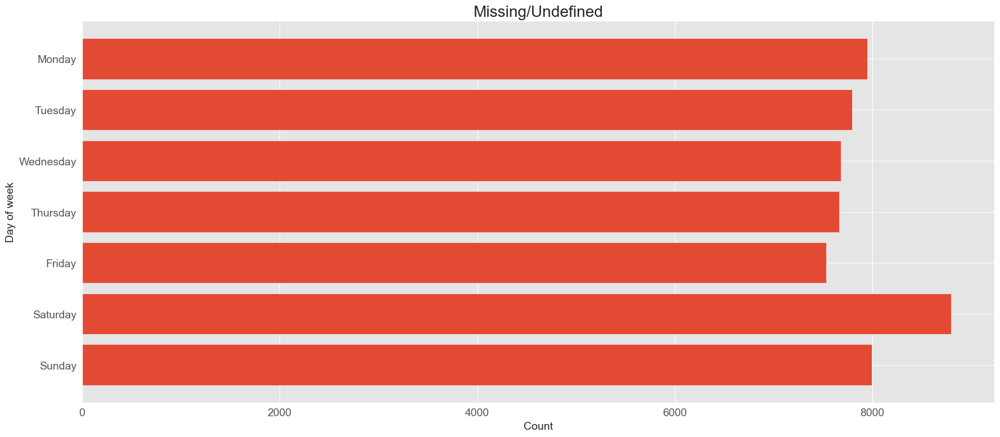

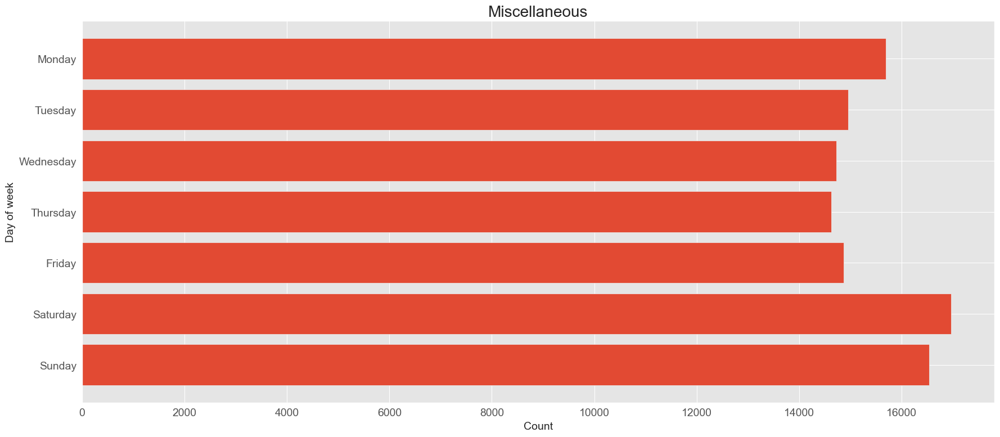

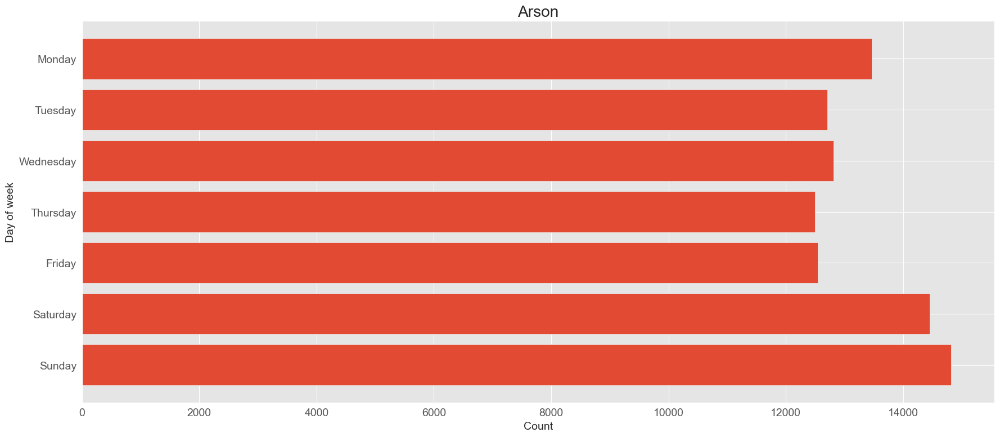

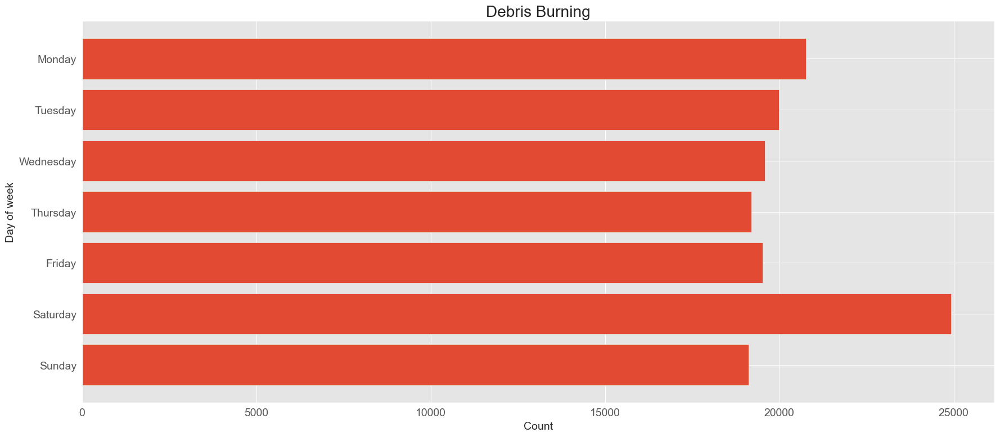

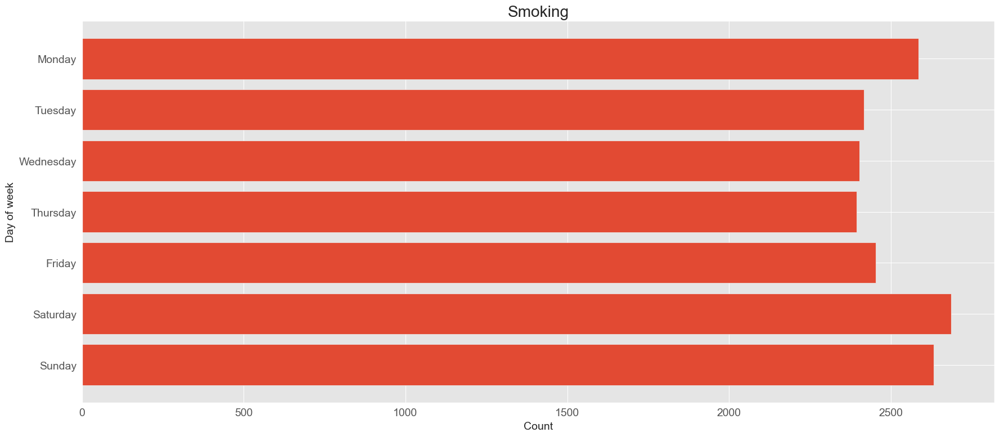

...

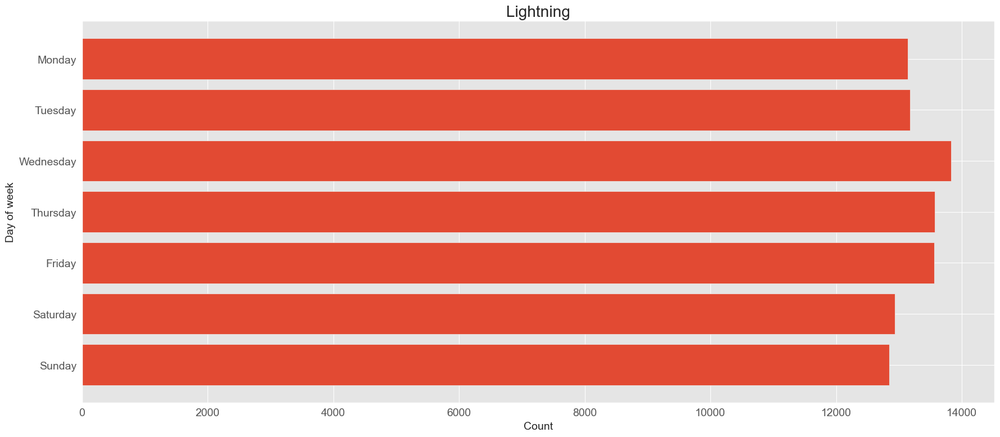

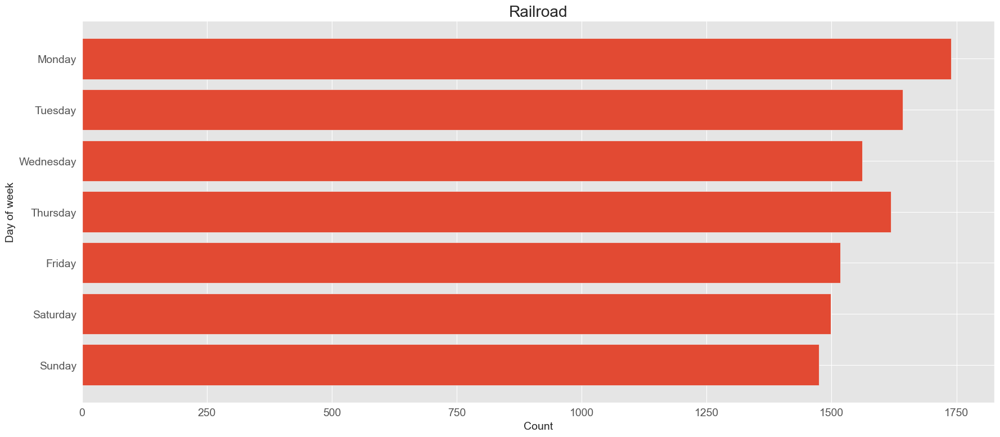

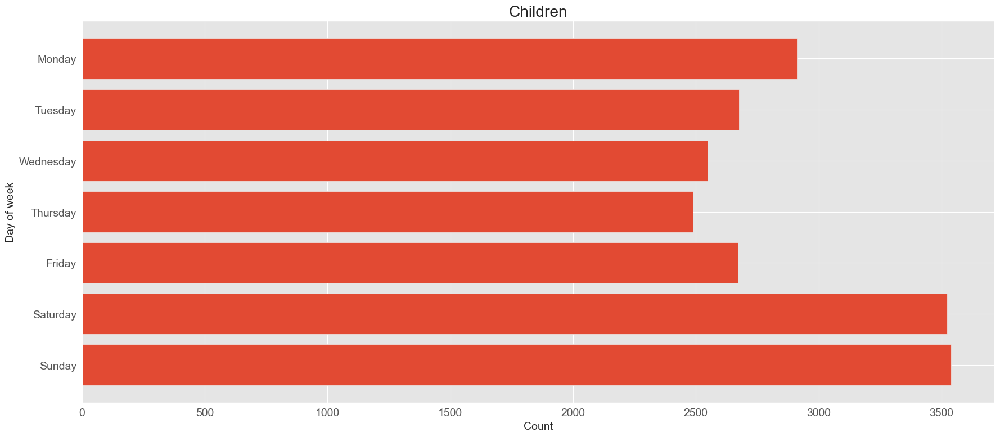

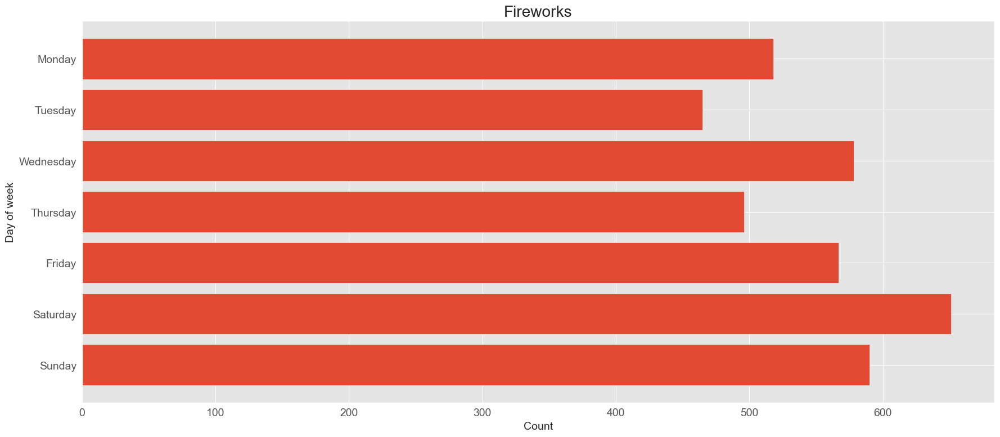

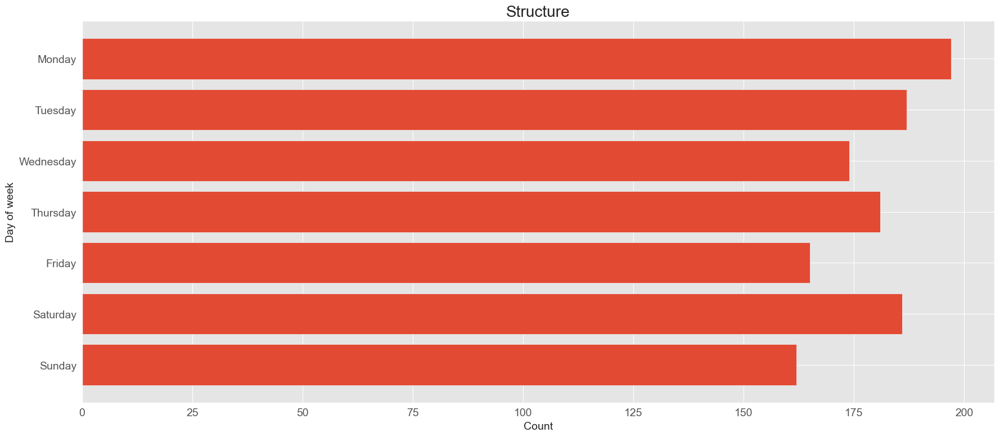

In [ ]:
# Loop over each label and plot a horizontal bar chart for the label
for label in df['STAT_CAUSE_DESCR'].unique():
    data = grouped[grouped['STAT_CAUSE_DESCR'] == label]
    # print(data)
    # print(data['DAY_OF_WEEK'])
    plt.barh(days_of_week, data['count'])
    plt.gca().invert_yaxis()  # Invert the y-axis
    plt.title(label)
    plt.xlabel('Count')
    plt.ylabel('Day of week')
    plt.show()

# Feature Engineering

## Utiliy functions

In [107]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

def scale(data):
  scaler = MinMaxScaler()
  data = pd.DataFrame(scaler.fit_transform(data), columns = data.columns)
  return data

def iterative_impute(data,feature):
  imp = IterativeImputer(max_iter=20, random_state=42)
  num_data = data.select_dtypes(include=np.number)
  num_data  =pd.DataFrame(imp.fit_transform(num_data),columns=num_data.columns)
  data[feature] = num_data[feature]
  return data

In [108]:
def one_hot_encoder(data, feature):
  one_hot = pd.get_dummies(data[feature])
  data = data.drop(feature,axis = 1)
  data = pd.concat([data, one_hot], axis = 1)
  # TODO when changing to transformers return only one hot without concat
  return data

  

## County Imputation by lat long

In [58]:
from shapely.geometry import Point
import geopandas as gpd
def extract_counties(data):
    gdf = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.LONGITUDE, data.LATITUDE), crs='epsg:4269')
    real_counties = gpd.read_file(f'{PRE_PATH}shape_files/cb_2015_us_county_500k.shp', crs='epsg:4269')
    real_counties = real_counties[['NAME', 'geometry', 'GEOID']]
    real_counties.rename(columns={'NAME': 'COUNTY_REAL'}, inplace=True)
    joined = gpd.sjoin(gdf, real_counties, how='left', op='within')
    return joined
    


### K-NN Imputer

In [59]:
# impute.KNNImputer(*[, missing_values, ...])

## Features per County 

### read county data

#### pcp and temp

In [60]:


from sklearn.impute import SimpleImputer

def extract_temp_pcp(data):
  # read data
  
  temp = pd.read_csv(f'{PRE_PATH}avg_temp.csv')
  pcp = pd.read_csv(f'{PRE_PATH}avg_precipitation.csv')

  # proccess data
  temp['Location'] = temp['Location'].str.replace(r' (County|City|Area)', '', regex=True)
  pcp['Location'] = pcp['Location'].str.replace(r' (County|City|Area)', '', regex=True)

  # map data
  temp_dict = dict(zip(temp['Location'], temp['1901-2000 Mean']))
  data['AVG_TEMP'] = data['COUNTY_REAL'].map(temp_dict)
  pcp_dict = dict(zip(pcp['Location'], pcp['1901-2000 Mean']))
  data['AVG_PCP'] = data['COUNTY_REAL'].map(pcp_dict)

  # impute nan's
  imp = SimpleImputer(strategy='mean')
  data['AVG_TEMP'] = imp.fit_transform(data['AVG_TEMP'].values.reshape(-1, 1))
  data['AVG_PCP'] = imp.fit_transform(data['AVG_PCP'].values.reshape(-1, 1))
  return data

#### county data

In [61]:
def extract_county_data(data):
  # read data
  
  county_data = pd.read_csv(f'{PRE_PATH}county_complete.csv')
  county_data['name'] = county_data['name'].str.replace(r' (County|City|Area)', '', regex=True)

  new_features = ['age_under_18_2010', 'black_2010', 'bachelors_2010', 'persons_per_household_2010', 'per_capita_income_2010',  'area_2010', 'density_2010', 'unemployment_rate_2010', 'smoking_ban_2010']
  imp = SimpleImputer(strategy='mean')
  for feature_name in new_features:
      # map data
      my_dict = dict(zip(county_data['name'], county_data[feature_name]))
      data[feature_name] = data['COUNTY_REAL'].map(my_dict)
  data['smoking_ban_2010'] = data['smoking_ban_2010'].map({"comprehensive": 2,"partial": 1, "none": 0})
  
  for feature_name in new_features:
    # impute nan's
    data[feature_name] = imp.fit_transform(data[feature_name].values.reshape(-1, 1))
  
  
  return data




    




### Holidays - CANCELED

In [62]:
from pandas.tseries.holiday import USFederalHolidayCalendar
HOLIDAY_SHIFT = 2 # DS_HP 2 is enough

def get_holidays(dataframe):

    # Define the date range you want to check for holidays
    start_date = pd.to_datetime('1992-01-01')
    end_date = pd.to_datetime('2015-12-31')

    # create a calendar for US federal holidays
    calendar = USFederalHolidayCalendar()

    # get the dates for all holidays within the specified range
    holidays = calendar.holidays(start=start_date, end=end_date, return_name=True)
    holidays = pd.DataFrame(holidays.rename('holiday'))
    holidays = holidays[holidays['holiday'].str.contains("New Year's Day|New Years")]
    # create a DataFrame with all dates within the specified range
    dates = pd.DataFrame({'DATE': pd.date_range(start_date, end_date, freq='D')})

    # merge the holidays with the dates DataFrame
    holidays_df = pd.merge(dates, holidays, how='left', left_on='DATE', right_index=True)
    holidays_df.fillna("", inplace=True)

    holidays_df['HOLIDAY'] = holidays_df['holiday'].shift(-2) + holidays_df['holiday'].shift(-1) + holidays_df['holiday'] + holidays_df['holiday'].shift(1) + holidays_df['holiday'].shift(2)

    holidays_df = holidays_df.replace(np.NaN, "New Year's Day")
    holidays_df = holidays_df.drop('holiday', axis=1)
    holidays_df.HOLIDAY = (holidays_df.HOLIDAY != "").astype(int)
    holiday_mapping = dict(zip( holidays_df.DATE, holidays_df.HOLIDAY))
    return dataframe.DATE.map(holiday_mapping)

# Baseline

## Prep all data 

In [84]:
raw_data = pd.read_csv(f'{PRE_PATH}train_data.csv')

In [122]:

# Separate the features and target variable
data ,y = raw_data.drop(columns = ['STAT_CAUSE_CODE'], axis=1), raw_data['STAT_CAUSE_CODE']
data = pd.read_csv(f'{PRE_PATH}train_data.csv')
data = base_preprocessing(data)
data = encode_time(data)
data = encode_state(data)
data = encode_label(data)
data = iterative_impute(data,'DISCOVERY_TIME')
data = extract_counties(data)
data = one_hot_encoder(data, "OWNER_CODE")
data = extract_temp_pcp(data)
data = extract_county_data(data)
data = data.drop(['STAT_CAUSE_DESCR', 'geometry', 'GEOID', 'index_right', 'COUNTY_REAL'], axis=1)
# Split the data, stratified by the label
X_train, X_test, y_train, y_test = train_test_split(data, y, test_size= 0.25, stratify =y, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, stratify=y_train, random_state=42)

In [123]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 626822 entries, 0 to 626821
Data columns (total 37 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   DAY_OF_MONTH                626822 non-null  int64  
 1   MONTH                       626822 non-null  int64  
 2   FIRE_YEAR                   626822 non-null  int64  
 3   STATE                       626822 non-null  int8   
 4   DAY_OF_WEEK                 626822 non-null  int64  
 5   FIRE_SIZE                   626822 non-null  float64
 6   LATITUDE                    626822 non-null  float64
 7   LONGITUDE                   626822 non-null  float64
 8   DISCOVERY_DOY               626822 non-null  int64  
 9   DISCOVERY_TIME              626822 non-null  float64
 10  0.0                         626822 non-null  uint8  
 11  1.0                         626822 non-null  uint8  
 12  2.0                         626822 non-null  uint8  
 13  3.0           

## Model Evaluation Framework

### Confusion Matrix

In [125]:


from sklearn.datasets import make_classification
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

def display_confusion(model, model_desc=""):
  predictions = model.predict(X_val)
  cm = confusion_matrix(y_val, predictions, labels=model.classes_)
  disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
  plt.figure(figsize=(8,10))
  disp.plot(xticks_rotation='vertical')
  save_fig(f"{PRE_PATH}{str(model).split('(')[0]}_{model_desc}_Confusion_matrix")
  plt.show()
  return cm


### Feauture Importance

In [78]:
def show_feature_importance(model):
  importances = model.feature_importances_
  feature_importances = pd.DataFrame({'feature': X_train.columns, 'importance': importances})
  feature_importances = feature_importances.sort_values('importance', ascending=False)
  print(feature_importances)

### F1 Score

In [71]:
from sklearn.metrics import f1_score

eval_model = lambda model: f1_score(y_val, model.predict(X_val), average='weighted')
model_score = lambda model: print(f"{type(model).__name__}'s weighted F1 score: {eval_model(model)}")

### F1 Score with CV

In [72]:
from sklearn.model_selection import KFold, cross_val_score

# Perform 5-fold cross-validation
kfold = KFold(n_splits=5, shuffle=True, random_state=42)
# scores = cross_val_score(xgb_model, X, y, cv=kfold, scoring='f1_weighted')

# Print cross-validation results
# print('Weighted F1 score:', np.mean(scores))

### train and eval model

In [75]:
import time
from datetime import datetime

def train_save_eval(model):
    # Train
    start = time.perf_counter()
    print(f'Attempting to train model')
    model.fit(X_train, y_train)
    end = time.perf_counter()
    now = datetime.now()
    current_time = now.strftime("%H:%M:%S")
    print(f'Successfully trained model in {end - start:.6f} seconds, end time:{current_time}')
    # Eval
    f1 = eval_model(model)
    print(f'weighted F1 score: {f1}')
    show_feature_importance(model)
    
    model_name = input("Enter model name or empty string:")
    
    if not model_name:
        model_name = model.__name__
    model_name += current_time
    display_confusion(model, model_name)
    # Save
    print(f'Attempting to save model')
    save_model(model, model_name)
    print(f'Saved model successfully with the name: {model_name}')

    print(f"Attempting to save model's weighted f1 score to the model_f1_log.txt file")
    with open(f'{PRE_PATH}Fire_Alert\model_f1_log.txt', 'a') as f:
        f.write(f'{model_name} weighted F1 score: {f1}')
    print(f'Saved model f1 score successfully')
    
    return f1


### Saving a model to a pickle (pkl) file

In [74]:
# Need to import pickle
save_model = lambda model, model_name: pickle.dump(model, open(f"{PRE_PATH}models/{model_name}.pkl", 'wb'))
# Load the saved model from disk
# loaded_model = pickle.load(open(filename, 'rb'))

# Model Selection

## Random Forest

Attempting to train model
Successfully trained model in 185.087052 seconds, end time:21:58:56
weighted F1 score: 0.5563119985256275
                       feature  importance
7                    LONGITUDE    0.124934
6                     LATITUDE    0.107438
9               DISCOVERY_TIME    0.088491
8                DISCOVERY_DOY    0.086395
2                    FIRE_YEAR    0.085030
0                 DAY_OF_MONTH    0.063850
5                    FIRE_SIZE    0.060879
4                  DAY_OF_WEEK    0.047288
1                        MONTH    0.042914
3                        STATE    0.031190
33                   area_2010    0.026205
34                density_2010    0.023491
26                    AVG_TEMP    0.022916
27                     AVG_PCP    0.021664
29                  black_2010    0.017995
15                         5.0    0.017795
32      per_capita_income_2010    0.017762
30              bachelors_2010    0.017494
35      unemployment_rate_2010    0.017414
31  pers

FileNotFoundError: ignored

<Figure size 576x720 with 0 Axes>

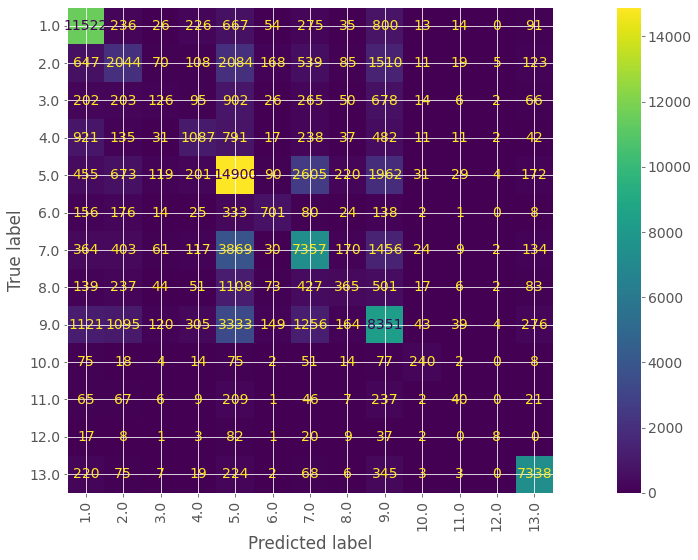

In [124]:
from sklearn.ensemble import RandomForestClassifier

# Create a Random Forest classifier with 100 trees
rfc = RandomForestClassifier(n_estimators=100, random_state=42)

# Fit the model to the data
train_save_eval(rfc)

# DRAFTS

In [97]:
from sklearn.ensemble import RandomForestClassifier

# Create a default Random Forest
rfc_default = RandomForestClassifier(n_estimators=100, random_state=42)

In [98]:
rfc_default.fit(X_train, y_train)

In [99]:
rfc_default_f1 = f1_score(y_test, rfc_default.predict(X_test), average='weighted')
print(rfc_default_f1)

In [100]:
rfc_balanced = RandomForestClassifier(n_estimators=100, class_weight='balanced', random_state=42)

In [101]:
rfc_balanced.fit(X_train, y_train)

In [102]:
y_pred = rfc_balanced.predict(X_test)
rfc_balanced_f1 = f1_score(y_test, y_pred, average='weighted')
print(rfc_balanced_f1)

In [104]:

# decision tree  on imbalanced dataset with SMOTE oversampling and random undersampling
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
# define pipeline
model = RandomForestClassifier(n_estimators=100, random_state=42)
over = SMOTE()
under = RandomUnderSampler()
steps = [('over', over), ('under', under), ('model', model)]
rfc_smote = Pipeline(steps=steps)
rfc_smote.fit(X_train, y_train)

In [105]:
y_pred = rfc_smote.predict(X_test)
rfc_smote_f1 = f1_score(y_test, y_pred, average='weighted')
print(rfc_smote_f1)

In [107]:
# evaluate pipeline
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
scores = cross_val_score(rfc_smote, X, y, scoring='f1_weighted', cv=cv, n_jobs=-1)
print(scores)

In [ ]:
# Score model
model_score(rfc)

# Get the feature importance scores
importances = rfc.feature_importances_

# Save the model to disk, pickle needs to be imported
model_name = input("enter the model name:") # 'rfc_model_n_est=100_random_state=42_split_states_cat_allholidays'
save_model(rfc, model_name)

# Create a DataFrame of feature importance scores
feature_importances = pd.DataFrame({'feature': X.columns, 'importance': importances})

# Sort the DataFrame by feature importance score in descending order
feature_importances = feature_importances.sort_values('importance', ascending=False)

# Print the feature importance scores
print(feature_importances)

In [ ]:
model_score(rfc)

### Results Summary

1. RFC with n_est=100 random_state=42 split states_ohe weighted F1 score: 0.5258918645236641
2. RFC with n_est=100 random_state=42 split states-regular-cat(!) weighted F1 score: 0.5419932376094608
3. RFC with n_est=100 random_state=42 split states-regular-cat(!), all_holidays(window=3) weighted F1 score: 0.5384525524359053
4. RFC with n_est=100 random_state=42 split states-regular-cat(!), chosen_holidays(window=0) weighted F1 score: 0.5310452912141282

### Confusion Matrix

In [ ]:
from sklearn.metrics import plot_confusion_matrix
conf_mat = plot_confusion_matrix(rfc, X_test, y_test)
conf_mat

### F1 Score with CV

In [ ]:
from sklearn.model_selection import KFold, cross_val_score

# Perform 5-fold cross-validation
kfold = KFold(n_splits=5, shuffle=True, random_state=42)
scores = cross_val_score(xgb_model, X, y, cv=kfold, scoring='f1_weighted')

# Print cross-validation results
print('Weighted F1 score:', np.mean(scores))

### Loading a model from a pickle file

In [ ]:
# Load the saved model from disk
filename = 'xgb_model_n_est=100_random_state=42_nosplit.pkl'
loaded_model = pickle.load(open(filename, 'rb'))
plot_importance(xgb_model)
plt.show()

In [ ]:
plot_importance(xgb_model)
plt.show()

In [ ]:
plot_importance(loaded_model)
plt.show()

## Hyper-parameter Tuning Framework

### Grid Search


### Random Search

### Inference Based

In [ ]:
import optuna
import xgboost as xgb


# Define objective function for optimization
def objective(trial):
    params = {
        'objective': 'binary:logistic',
        'eval_metric': 'logloss',
        'n_estimators': 100,
        'learning_rate': trial.suggest_uniform('learning_rate', 0.01, 0.3),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
        'gamma': trial.suggest_uniform('gamma', 0.0, 1.0),
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-8, 100.0),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-8, 100.0)
    }

    model = xgb.XGBClassifier(**params)
    model.fit(X_train, y_train)
    f1 = f1_score(y_val, model.predict(X_val), average='weighted')
    return f1

# Define study
study = optuna.create_study(direction='minimize')

# Run optimization
study.optimize(objective, n_trials=100)

# Print best hyperparameters and validation error
print('Best hyperparameters: {}'.format(study.best_params))
print('Validation f1 score (weighted): {:.3f}'.format(study.best_value))

## Advanced Modeling Techniques

## One-vs-Rest Classification

In [ ]:
from sklearn.multiclass import OneVsRestClassifier
from sklearn.svm import SVC
clf_OvR = OneVsRestClassifier(SVC()).fit(X_train, y_train)

In [ ]:
model_score(clf_OvR)

## One-vs-One Classification

In [ ]:
from sklearn.multiclass import OneVsOneClassifier
from sklearn.svm import LinearSVC
clf_OvO = OneVsOneClassifier(LinearSVC(random_state=42)).fit(X_train, y_train)